# Búsqueda y Optimización con algorimos genéticos

**  El notebook está diseñado para no tener que ser ejecutado. Todos los videos, tablas o graficos necesarios estan cargados desde local para poder ser vistos. Es importante tener la carpeta de resultados para verlos. Todas las celdas son ejecutables para ver que correstamente funciona y no hay problema de borrado de datos. Si esa ejecución ya existe, dará un error en el guradado de resultados y no modificará los presentados. Todas las ejecuciones aparte de almacenarlos los muestra por pantalla para confirmar que funcionan

En esta práctica vamos a explorar los *Algoritmos Genéticos* para solucionar un problema de optimización real. 

El problema propuesto a solucionar es un problema de optimización de parámetros para cosneguir un mejor algoritmo de busqueda de viajes.  

El problema consiste en la optimización entre los valores 0 y 255 de los siguientes diez parámetros:

1- Caché resultados consulta Routing Module (RTG) 

2- Caché número resultados consulta conexiones 

3- Buffer combinaciones rutas I 

4- Buffer combinaciones rutas II 

5- Buffer de tarifas 

6- Buffer de tasas/impuestos 

7- Buffer resultado consulta tarifas combinaciones de paquetes
vacacionales 

8- Caché resultados consulta viaje combinado 

9- Tiempo máximo de layover

10- Tiempo máximo de viaje (adicional) 

## Fuerza Buta

El primer ejercicio de la práctica pide resilver para un individuo con tres cromosomas el problema propuesto. 
La fuerza bruta no es otra cosa que pprobar todos los valores posibles con un orden lógico o no. siempre que no se repitan las pruebas, hasta llegar a la solución en cuestión.
el siguiente código presenta la solución recorriendo todas las posibles soluciones y llamando a la función de fitness.

In [ ]:
import requests

best_value = [10000000,'no es nada',[-1,-1,-1]]

for i in range(0,256):
    for j in range (0,256):
        for k in range (0,256):
            ind = "{0:08b}".format(i)+"{0:08b}".format(j)+"{0:08b}".format(k)
            fitness = requests.get('http://memento.evannai.inf.uc3m.es/age/test?c='+ ind )
            fitnessvalue = float(fitness.text)
            if (fitnessvalue < best_value[0]): 
                print('Best value changed {}, individual {}, numeros {}'.format(fitnessvalue,ind,[i,j,k]))
                best_value[0] = fitnessvalue
                best_value[1] = ind
                best_value[2] = [i,j,k]
            

Pasados 16 minutos de ejecución del código propuesto la salida fue la siguiente:

Best value changed 11626.21, individual 000000000000000000000000, numeros [0, 0, 0] 

Best value changed 11621.09, individual 000000000000000000000010, numeros [0, 0, 2]

Best value changed 11616.09, individual 000000000000000000001010, numeros [0, 0, 10]

Best value changed 11615.01, individual 000000000000000010000010, numeros [0, 0, 130]

Best value changed 11610.01, individual 000000000000000010001010, numeros [0, 0, 138]

Best value changed 11136.17, individual 000000000000010000000000, numeros [0, 4, 0]

Best value changed 11131.05, individual 000000000000010000000010, numeros [0, 4, 2]

Best value changed 11126.05, individual 000000000000010000001010, numeros [0, 4, 10]

Best value changed 11124.97, individual 000000000000010010000010, numeros [0, 4, 130]

Best value changed 11119.97, individual 000000000000010010001010, numeros [0, 4, 138]

Best value changed 11002.81, individual 000000000001010000000000, numeros [0, 20, 0]

Best value changed 10997.69, individual 000000000001010000000010, numeros [0, 20, 2]

Best value changed 10992.69, individual 000000000001010000001010, numeros [0, 20, 10]

Best value changed 10991.61, individual 000000000001010010000010, numeros [0, 20, 130]

Best value changed 10986.61, individual 000000000001010010001010, numeros [0, 20, 138]

Best value changed 10837.02, individual 000000000010010000000000, numeros [0, 36, 0]

Best value changed 10831.9, individual 000000000010010000000010, numeros [0, 36, 2]

Best value changed 10826.9, individual 000000000010010000001010, numeros [0, 36, 10]

Best value changed 10825.82, individual 000000000010010010000010, numeros [0, 36, 130]

Best value changed 10820.82, individual 000000000010010010001010, numeros [0, 36, 138]


La media de timepo que tarda el algoirmot en generar y valorar las posibles osluciones es de 1 segundo por lo que dicho algoritmo tardará 279.602 minutos o 4660 horas o 194 dias y 5 horas en probar todas las posibles combinaciones para este caso reducido de fuerza bruta ya que 256 ^ 3 es igual a 16.777.216.

Este ejercicio demuestra de la utilidad de la computación evolutiva y lo presenta como técnicas de búqsqueda útiles cuando el espacio de busqueda es inmenso y la fuerza bruta es un acercamiento absurdo. Con una serie de indicaciones y de ténicas presentadas por los investigadores del campo se puede llegar a un optimo local o global con tiempos de computación mucho más pequeños


## Algoritmos Genéticos

In [7]:
import requests
import numpy as np
import random
import pandas as pd
import datetime as datetime
import matplotlib.pyplot as plt
import time
import pylab as pl
from IPython import display
from IPython.display import Image
! pip install imageio
import imageio
import os

You should consider upgrading via the '/Library/Frameworks/Python.framework/Versions/3.8/bin/python3 -m pip install --upgrade pip' command.


In [166]:
class AlgoritmosGeneticos:
    def __init__ (self,population_size,number_chromosomes,number_genes,random_mutation = 0.03, fitness_function = 'test', verbose = False):
        self.population_size = population_size
        self.number_chromosomes = number_chromosomes
        self.number_genes = number_genes
        self.population = np.random.randint(2, size=(population_size, number_chromosomes,number_genes))
        self.url_test = 'http://memento.evannai.inf.uc3m.es/age/test?c='
        self.url_alpha = 'http://memento.evannai.inf.uc3m.es/age/alfa?c='
        self.url_easydc = 'http://memento.evannai.inf.uc3m.es/age/easydc?c='
        self.fitness_values = []
        self.fitness_mean = []
        self.fitness_worst = []
        self.fitness_function = fitness_function
        self.tournament_count = population_size
        self.tournament_size = 0
        self.tournament_size_list = []
        self.random_mutation = 0
        self.intermidiate_population = []
        self.verbose = verbose
        self.train_results = pd.DataFrame(columns = ['Epoch','Fitness Value','Fitness Mean Value','Fitness Worst Value','Individual'])
        self.last_train_results = []
        self.figures = []
        self.permited_mutation = 3

    def __indv_to_string(self,ind):
        return np.array2string(ind)[1:-1].replace('\n','').replace(' ','').replace('[','').replace(']','')
    
    def __call(self,chromosome):
        if(self.fitness_function == 'test'):
            return requests.get(self.url_test + chromosome)
        elif (self.fitness_function == 'alfa'):
            return requests.get(self.url_alpha + chromosome)
        elif (self.fitness_function == 'easydc'):
            return requests.get(self.url_easydc + chromosome)
        
    def __fit_population(self):
        fitness_new = []
        for ind in self.population:
            fitness_new.append(float(self.__call(self.__indv_to_string(ind)).text))
        self.fitness_mean.append(sum(fitness_new)/len(fitness_new))
        self.fitness_worst.append(max(fitness_new))
        self.fitness_values = fitness_new.copy()
    
    def fit_population_ext(self,population):
        fitness_new = []
        for ind in population:
            fitness_new.append(float(self.__call(self.__indv_to_string(ind)).text))
        return fitness_new

    def __best_of_population(self):
        self.__fit_population()
        best_value = min(self.fitness_values)
        return best_value, self.fitness_values.index(best_value)
    
    def __tournament(self):
        
        selected_for_coupling = []
        for i in range(self.tournament_count): #numero de toneos
            
            tournament_fitness = []
            tournament_selection = []
            for j in range(self.tournament_size): # tamaño de los torneos
                tournament_selection.append(random.randint(0,self.population_size-1))
                tournament_fitness.append(self.fitness_values[tournament_selection[j]])
            winner_fitness = min(tournament_fitness)
            winner_position = tournament_fitness.index(winner_fitness)
            selected_for_coupling.append(self.population[tournament_selection[winner_position]])
        self.intermidiate_population = selected_for_coupling
    
    def __adapt_tournament_size(self,epochs_list):
        previous_size = self.tournament_size
        posicion = int(epochs_list[0]/(epochs_list[1]/len(self.tournament_size_list)))
        if posicion > len(self.tournament_size_list) -1 : posicion -= 1
        self.tournament_size = self.tournament_size_list[posicion] #Avanzar de manera progresiva aumentando el tamaño del tournament -> Presión selectiva
        next_size = self.tournament_size
        if(previous_size != next_size): print("El tamaño del tournament ha cambiado de {} a {} ".format(previous_size,next_size))
            
    def __coupling(self):
        coupled_population = []
        for i in range(0, len(self.intermidiate_population), 2):
            for j in range(0,2):
                coupled_population.append(self.__compute_son(self.intermidiate_population[i],self.intermidiate_population[i+1]))
        self.intermidiate_population = coupled_population
    
    def __compute_son(self,father,mother):
        child = np.random.randint(2,3,size=(10,8)) 
        for gene_f,gene_m,gene_s in zip(father,mother,child):
            for i in range(len(gene_f)): 
                if(random.random()<= 0.5): gene_s[i] = gene_f[i]
                else: gene_s[i] = gene_m[i]
        return child
    
    def __mutate_population(self, mutation_type='complete'):
        
        if(mutation_type == 'complete'):
            for individual in range(0,len(self.intermidiate_population)):
                for chromosome in range(0,len(self.intermidiate_population[individual])):
                    for gene in range(0,len(self.intermidiate_population[individual][chromosome])): 
                        if ( random.random() <= self.random_mutation):
                            if(self.intermidiate_population[individual][chromosome][gene] == 1): self.intermidiate_population[individual][chromosome][gene] = 0
                            else: self.intermidiate_population[individual][chromosome][gene] = 1
        elif(mutation_type == 'partial' ):
            for individual in range(0,len(self.intermidiate_population)):
                for chromosome in range(0,len(self.intermidiate_population[individual])):
                    for gene in range(len(self.intermidiate_population[individual][chromosome]) - 3,len(self.intermidiate_population[individual][chromosome])): 
                        if ( random.random() <= self.random_mutation):
                            if(self.intermidiate_population[individual][chromosome][gene] == 1): self.intermidiate_population[individual][chromosome][gene] = 0
                            else: self.intermidiate_population[individual][chromosome][gene] = 1
        elif(mutation_type == 'boosted_partial' ):
            for individual in range(0,len(self.intermidiate_population)):
                for chromosome in range(0,len(self.intermidiate_population[individual])):
                    for gene in range(len(self.intermidiate_population[individual][chromosome]) - self.permited_mutation,len(self.intermidiate_population[individual][chromosome])): 
                        if ( random.random() <= self.random_mutation):
                            if(self.intermidiate_population[individual][chromosome][gene] == 1): self.intermidiate_population[individual][chromosome][gene] = 0
                            else: self.intermidiate_population[individual][chromosome][gene] = 1
        
    def __save_training(self,folder):
        path = os.path.join('resultados/AlgoritmosGeneticos', folder)
        os.mkdir(path)
        video_path = os.path.join(path, 'video.gif')
        imageio.mimsave(video_path, self.figures,fps=2)
        images_path = os.path.join(path, 'images')
        os.mkdir(images_path)
        os.chdir(images_path)
        for epoch,image in enumerate(self.figures):
            imageio.imwrite('image_epoch{}.jpg'.format(epoch + 1),image)
        os.chdir("../../../..")

    def save_training_results(self,folder):
        path = os.path.join('resultados/AlgoritmosGeneticos', folder, "resultados_ce_ganador_{}.csv".format(datetime.datetime.now()))
        self.train_results.to_csv(path)
    
    def population_to_integers(self):
        population_integers = []
        for ind in self.population:
            individual = []
            for chromosome in ind:
                value = np.array2string(chromosome)[1:-1].replace('\n','').replace(' ','').replace('[','').replace(']','')
                for i in range(0,10):
                    individual.append(int(value, 2))
            population_integers.append(individual)
        return population_integers
        
    def plot_training(self, epoch,results = 'last', ):
        if results == 'whole':
            self.last_train_results.plot(kind='line',x='Epoch',y='Fitness Value')
        elif results == 'last': 
        
            fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(16, 7))
            fig.suptitle('AG search epoch {}'.format(epoch))
            
            text_kwargs = dict(ha='center', va='center', fontsize=15, color='blue')

            ax1.plot(self.last_train_results['Epoch'],self.last_train_results['Fitness Value'], label='Best Value',color = 'blue')
            ax1.plot(self.last_train_results['Epoch'],self.last_train_results['Fitness Mean Value'], label='Mean Value',color = 'orange')
            ax1.plot(self.last_train_results['Epoch'],self.last_train_results['Fitness Worst Value'], label='Worst Value',color = 'red')
            ax1.text((epoch -1)*0.49, ax1.get_ylim()[1] * 0.80,'{}'.format(round(self.last_train_results['Fitness Value'].iloc[-1],2)), **text_kwargs)
            ax1.set_title('Population fitness')
            ax1.legend()

            ax2.bar(range(0,self.population_size),self.fitness_values)
            ax2.set_title('Individual fitness')
            
            ims_plot = ax3.imshow(self.population_to_integers(),cmap = plt.cm.twilight)
            ax3.set_title('Individual Chromosomes')
            ax3.axis('off')
            plt.colorbar(ims_plot)

            

            fig.canvas.draw()       # draw the canvas, cache the renderer
            image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
            image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
            self.figures.append(image)

            display.clear_output(wait=True)
            display.display(pl.gcf())
        else: None
    
    def __compute_new_population(self,volume):
        previous = list(zip(self.population,self.fitness_values))
        new = list(zip(self.intermidiate_population, self.fit_population_ext(self.intermidiate_population)))

        def retreive_fitness(element):
            return element[1]

        new.sort(key = retreive_fitness)
        previous.sort(key = retreive_fitness)

        previous_selected = []
        for i in range(int(self.population_size * (1 - volume))):
            previous_selected.append(previous[i][0])
        
        new_selected = []
        for i in range(len(new)):
            new_selected.append(new[i][0])
        
        final_pop = new_selected[:len(new_selected)-len(previous_selected)]
        final_pop.extend(previous_selected)

        random.shuffle(final_pop)

        return final_pop

    def __compute_bitflip_maximum(self):
        print('Cheking....')
        if (self.permited_mutation < 5 and ((self.train_results['Fitness Value'].iloc[-3:].mean() - self.train_results['Fitness Value'].iloc[-1:]) == 0).iloc[0]): 
            self.permited_mutation +=1
            print('Permited Mutation incremented to {}'.format(self.permited_mutation))
            

    
    def search(self,epochs, save_results, plot_training, tournament_size, insercion_volume,selection_method = 'tournament', optimization = {"min": 4,"max":8, "steps":2}, mutation= {"mtype": 'partial', "probability": 0.03},verbose = False):
        self.tournament_size = tournament_size
        self.verbose = verbose
        self.random_mutation = mutation['probability']
        if (optimization != None):
            name = 'AG_F{}_I{}_Ch{}_G{}_M{}_T{}_Op{}_Mut{}_In{}_E{}'.format(self.fitness_function,self.population_size,self.number_chromosomes,self.number_genes,selection_method,tournament_size,list(optimization.values()),list(mutation.values()),insercion_volume,epochs)
        else: name = 'AG_F{}_I{}_Ch{}_G{}_M{}_T{}_Op{}_Mut{}_In{}_E{}'.format(self.fitness_function,self.population_size,self.number_chromosomes,self.number_genes,selection_method,tournament_size,None,list(mutation.values()),insercion_volume,epochs)
         

        if (optimization != None):
            self.tournament_size_list = list(range(optimization['min'], optimization['max']+1,optimization['steps']))
            print('La matriz de tour size es de {}'.format(self.tournament_size_list))
        
        results_data = pd.DataFrame(columns = ['Epoch','Fitness Value','Fitness Mean Value','Fitness Worst Value','Individual'])

        best_value, best_ind_index = self.__best_of_population()
        print('Initial fitness winner {}'.format((best_value)))

        results_data.loc[len(results_data)] = [-1,best_value,self.fitness_mean[-1],self.fitness_worst[-1],self.__indv_to_string(self.population[best_ind_index])]
        self.train_results.loc[len(self.train_results)] = [-1,best_value,self.fitness_mean[-1],self.fitness_worst[-1],self.__indv_to_string(self.population[best_ind_index])]

        

        for epoch in range(1,epochs + 1):  
             
            print('Epoca de entrenamiento n {}'.format(epoch))

            intermidiate_population = []
            if selection_method == 'tournament': 
                if (optimization != None):
                    self.__adapt_tournament_size([epoch,epochs])
                self.__tournament()

            self.__coupling()
            if(epoch > 3 and mutation['mtype'] == 'boosted_partial'): self.__compute_bitflip_maximum()
            self.__mutate_population(mutation['mtype'])
            
            if insercion_volume == 1: self.population = self.intermidiate_population
            else: self.population = self.__compute_new_population(insercion_volume)
            
            best_value, best_ind_index = self.__best_of_population()
            print('Best fitness {}'.format(best_value))

            results_data.loc[len(results_data)] = [epoch,best_value,self.fitness_mean[-1],self.fitness_worst[-1],self.__indv_to_string(self.population[best_ind_index])]
            self.train_results.loc[len(self.train_results)] = [epoch,best_value,self.fitness_mean[-1],self.fitness_worst[-1],self.__indv_to_string(self.population[best_ind_index])]

            self.last_train_results = results_data

            if plot_training: self.plot_training(epoch)
            print('Best fitness {}'.format(best_value))
            
            if best_value == 0: 
                print('La función de adecuación ha convergido a 0, fin de la ejecución \n El individo que ha parado la ejecución es {}'.format(self.population[best_ind_index]))
                break
        
        if plot_training: self.__save_training(name)
        if (plot_training and save_results): self.save_training_results(name)
        return name + '/video.gif'

Los nombres de archivos de resultados siguen la siguiente nomenclatura: 'AG_F{}_I{}_Ch{}_G{}_M{}_T{}_Op{}_Mut{}_In{}_E{}'. Coinciden con el tipo de población y entrenamiento seguido.

    Algoritmos Genéticos:

    (F) Función sobre la que se ha valorado el fitness de los individuos (test,alfa o easydc)

    (I) Numero de Individuos en la población

    (Ch) Número de cromosomas por individuo (Va a ser siempre 10)

    (G) Genes binarios por cromosoma (Va a ser siempre 8)

    (M) Método de Selección (torneo, ruleta...)(es posible que se implemente solo torneo ya que se verá la ruleta en la p2)

    (T) Tamaño de torneo

    (Op) Optimización del método del torneo. Tamaño de torneo cambiante para crear presion selectiva

    (Mut) Tipo de Mutación. Completa o parcial

    (In) Insercion. Porcentaje de la población que varia en cada iteración. 100 sustitución completa.

    (E) Número de épocas que plantearon (si llega antes a cero la ejecución se para)

Todas las pruebas realizadas se pueden ver en la carpeta de resutados con esta nomenclatura.


### Pruebas Test 

La primera prueba que se ha realizado ha sido con los valores propuestos en clase. 
La primera mutación que se implementó fue la mutación completa, mutación en la cual existe una probabilidad x de mutar (bittlip) cada uno de los genes de cada uno de los cromososmas de cada individuo. Esto aplicado al problema que estamos solucionando carece de sentido ya que para un cromosoma cuyo valor sea actualmente 0 con un único bitplip puede convertirlo en 255 alterando completamente el entrenamiento que lleve esa ejecución debido a que se introduce un individio completamente ditinto, casi aleatorio. La idea de la mutación es crear diversidad genética pero siempre dentro de los rangos en los cuales se este moviendo la población. 
De la manera que esta planteado el problema la mutación se debería hacer sobre el valor decimal de cada cromosoma, pero debido a que los valores está codificados en binario se ha llegado al siguiente acercameinto. Se ha llamado mutación parcial, mutación apropiada para este problema, en la cual solo se permiten mutar los últimos tres bits de cada cromosoma permitiendo movimientos a lo sumo de +-7.
Un cromosoma cuyo valor sea xxxxx000 podría mutar a lo sumo, con muy bajas probabilidades a, xxxxx111 alterando su valor absoluto en 7 unidades.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 30
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization= None,mutation= {"mtype": 'complete', "probability": 0.03}, save_results = True, plot_training = True)

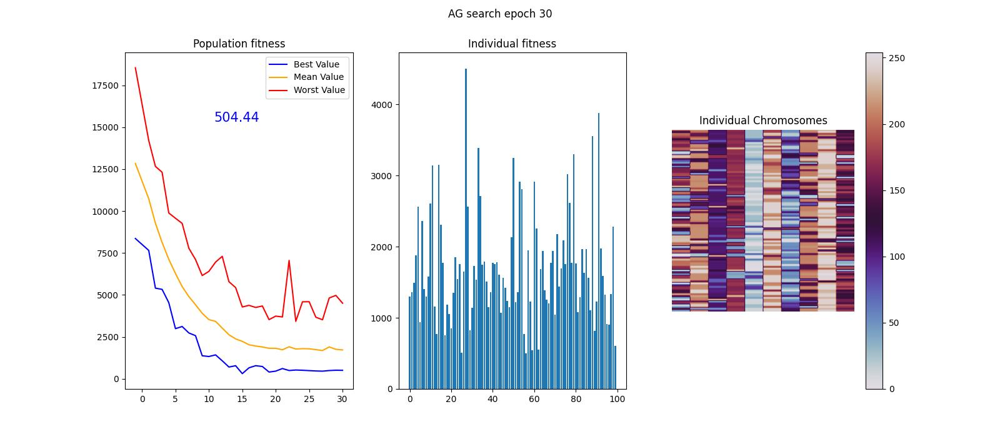

In [10]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['complete', 0.03]_In100_E30/images/image_epoch30.jpg")

En esta primera ejecución podemos ver que el fitnes no ha llegado a ser 0. El modelo converge pero no es óptimo debido a varios problemas que se pueden observar. 

El primero de ellos y más obvio es que el algoritmo no ha encontrado una solución cuyo fitnes sea 0. 

Segundo por la grafica de individual fitness (subplot 2) podemos apreciar que muchos de los indiviuos finales aun tienen un fitness muy alto. Esto se puede deber a la mutación completa utilizada. Estos individous salen del cruce de individuos con posiblemente mejores fitness individuales pero que al hacer bitflip aleatorio por cada gen perdemos su eficacia si este cambia en los bits altos del cromosoma debido a que lo convierte en un valor completamente diferente. Cabe añadir que esto se podría dar incluso con una mutación parcial peor para esta función de fitness (test), despues de sucesivas pruebas uno se da cuenta que la función no es tan ruidosa y que sucesivas épocas tengan peores valores no se debería dar tan frecuentemente.

Por último si nos fijamos el gráfico population fitness que revela los valores Máximo, Medio y Mínimo de la función fitness sobre la población podemos apreciar que todos los valores a lo largo del entrenamiento han ido fluctuando, cuando no deberían , o al menos no muchas veces, tener peor fitness poblaciones sucesivas. Este problema podemos apreciar que ocurre bastantes veces durante el entrenamiento. 

El siguiente video lo hace evidente que en ciertas épocas el mejor individuo es altamente inferior al de la población previa. Esto se debe tambien en parte a la estrategia de inserción adoptada ya que todos los indiviuos generados por cruce y mutación pasan a ser los nuevos individuos de la siguiente población.

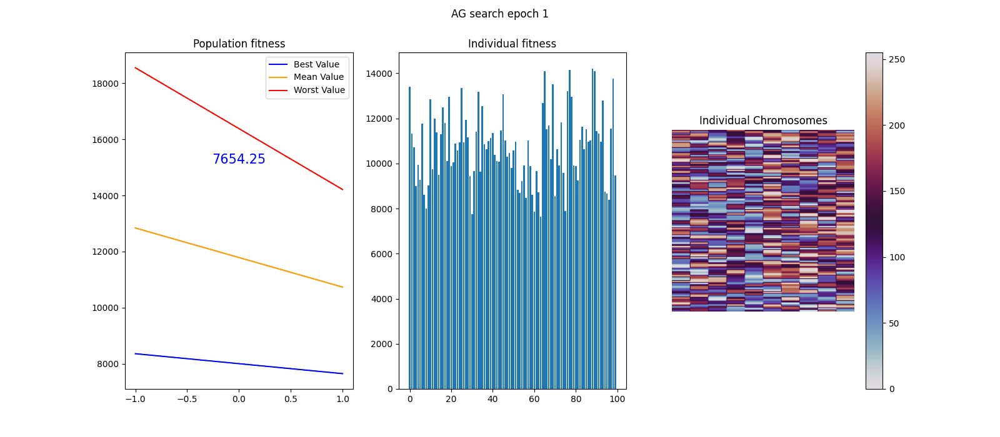

In [11]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['complete', 0.03]_In100_E30/video.gif")

El siguiente ejemplo que se platea es el de una presión selectiva muy alta desde el inicio (tamaño del tornero igual al tamaño de la población). Esta presión selectiva implica que en la mayoría de los torneos va a pasar el mejor individo como seleccionado para el cruce (no siempre ya que la selección previa al torneo es aleatoria). Si todos los individuos, o la mayoria, son idénticos el cruce carece de sentido y la unica diversidad que se geenra es por la mutación. Al haber mutación completa de alguna forma encuentra la solución. Con el siguiente video podemos apreciar claramente lo que esta pasando.

Se ha ampliado el número de épocas debido a que normalmente converge a 0 al rededor de la época 30, por asegurar que llega a la solución final se ha ampliado a 40.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 100,insercion_volume=1,optimization= None,mutation= {"mtype": 'complete', "probability": 0.03}, save_results = True, plot_training = True)

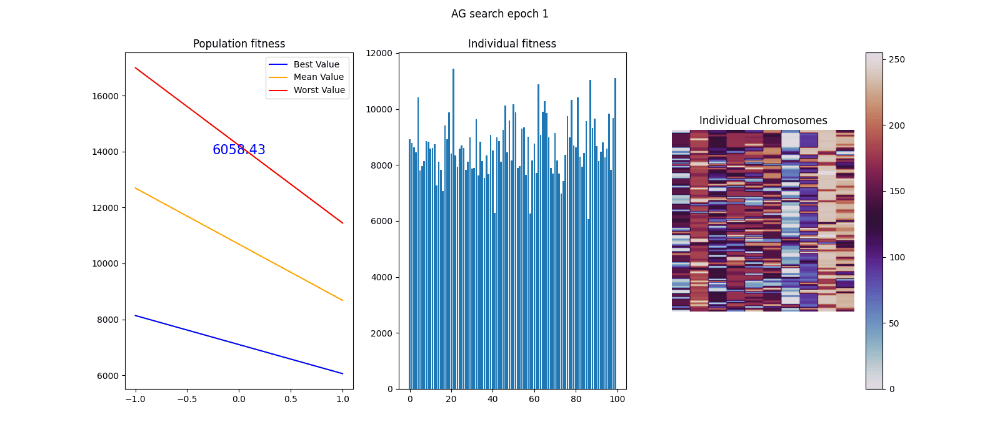

In [14]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T100_OpNone_Mut['complete', 0.03]_In100_E40/video.gif")

Esta ejecución es muy interesante y en base al video se van a hacer muchos comentarios.

- Podemos ver que se ha 'solucionado' el problema previo de que el mejor valor de una época previa podía ser mucho mejor que el mejor individo de la siguiente aun manteniendo la inserión poblacional a 100. Esto se debe al tamaño del torneo. Al ser tan grande es muy probable que el mejor individuo pase y pase más de una vez, reduciendo la varuabilidad genética de la población. Este acecamiento no es el deseado debido a que es siempre mejor un torneo pequeño y una politica de inserción donde nos quedemos con un porcentaje de los mejores individuos de la población previa.

- Esta selección de parámetro siempre converge y ahora mas adelante se va a demostrar con un conjunto de ejecuciones completas, pero esta muy lejos de ser la optima. Como podemos ver la ejecución se queda parada 11 épocas en el fitnes igual a 2,77. Esto se debe ya que la unica forma de mejorar en este modelo se reduce basicamente a la probablilidad de que con una mutación aletoria baje derepente el valor a 0 pero esa posibilidad es baja por lo que se queda paralelo a cero durante un tiempo.

- Si nos fijamos en el subplot de individual fitnes podemos observar claramente que muchos indiviuos son identicos y existen despues muchos indiviuos con fitness disparados. Esto se debe a la mezcla de toneos tan alta y la mutación completa. Los individuos depués de ser cruzados de alguna forma se convierten en aletaorios al tener una mutación de este tipo.

- En cada epoca, a partir de quinta o sexta podemos aprecia que los individuos en su mayoría son identicos en los cromosomas y solo tienen valores distintos en determinados puntos. Esos puntos son excatmente donde la mutación ha actuado y ha brindado toda la variabilidad genética a la población. En la siguiente imagen se ve claramente. Todas las columnas tienen un valor predominante exceptuando en puntos determinados donde tiene un color en ocasiones comletamente diferente. Ahí es donde se ha producido la mutación.

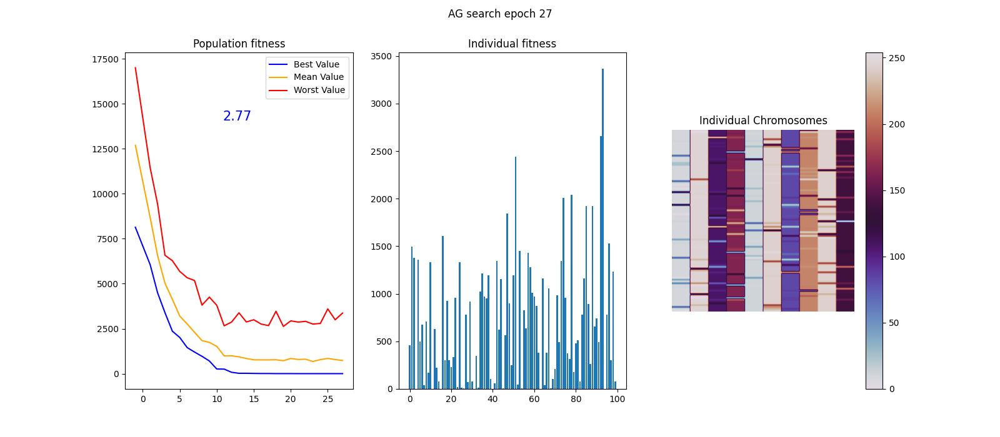

In [15]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T100_OpNone_Mut['complete', 0.03]_In100_E40/images/image_epoch27.jpg")

Por simple curiosidad y sabiendo que es un acercamiento completamente erroneo se va a realizar el mismo entrenaiento que antes pero estabeciendo la mutación a 0 (única vía por la cual el modelo encontraba la solución).Este experimento pretende demostrar que en pocas iteraciones se va a consegui una población identica completamente identica y el algoritmo se va a quedar estancado.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 5
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 100,insercion_volume=1,optimization= None,mutation= {"mtype": 'complete', "probability": 0.0}, save_results = True, plot_training = True)

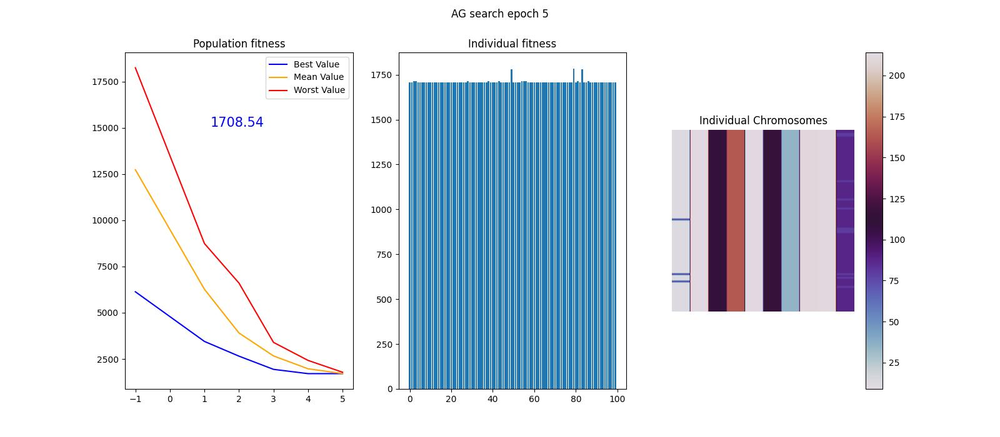

In [18]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T100_OpNone_Mut['complete', 0.0]_In100_E5/images/image_epoch5.jpg")

Como era de esperar, con solo 5 épocas se ha conseguido que los valores del mejor, la media y el peor sean iguales, todos los individuos tengan el mismo fitness debido a que tienen el mismo valor en todos sus cromosomas como podemos apreciar en el subplot del valor de los cromosomas. 

In [ ]:
modelos = []
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
for i in range(5):
  modelos.append(AlgoritmosGeneticos(pop_size,chro_size,gene_size))

for value,model in enumerate(modelos):
    print('Entrenando modelo {}'.format(value))
    model.search(training_epochs,tournament_size = 100,insercion_volume=1,optimization= None,mutation= {"mtype": 'complete', "probability": 0.03}, save_results = False, plot_training = False)
  
def retreive_epochs(element):
    return element.last_train_results['Epoch'].iloc[-1]

def retreive_fitness(element):
    return element.last_train_results['Fitness Value'].iloc[-1]

fit = [retreive_fitness(element) for element in modelos]
epoch = [retreive_epochs(element) for element in modelos]

plt.scatter(range(len(fit)),fit)
plt.scatter(range(len(epoch)),epoch)
plt.title('Fitness and Epoch values')
plt.grid()

La prueba se ha realizado con unicamente 5 modelos por los tiempos de ejecución pero todos los modelos han encontrado la solución óptima. En la siguiente figura se muestra en los puntos azules el fitness obtenido frente al npodemos observar que el número de épocas necesarias para converger se mueve en la franja de 23 a 32 épocas pero siempre encuentra el valor 0.

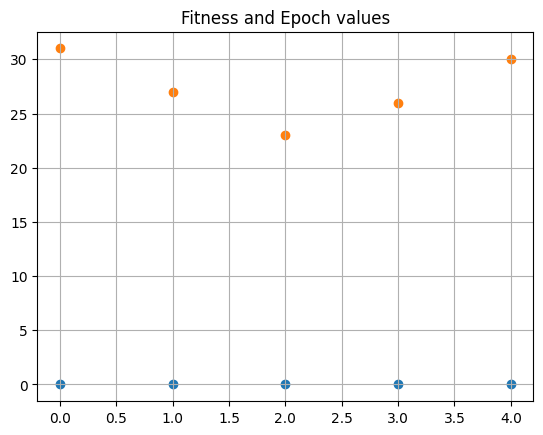

In [29]:
Image("resultados/AlgoritmosGeneticos/" + "AG_100_5P_1245.png")

Dejamos de lado el experimento anterior y probamos ejecuciones con torneos de tamaño más pequeño. La idea del torneo es escoger a los mejores pero de manera aleatoria, es decir, que no solo el mejor pase sino que haya algo de diversidad. Además vamos a añadir que los 5 mejores individuos previos pasen a la siguiente población para asegurar no perderlos, aunque por los torneos tambien puede ser elegidos. La selección de los individuos la hacemos bajando el valor de inserción a 0.95, que sobre poblaciones de 100 implica que entran los 5 primeros.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 30
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=0.95,optimization= None,mutation= {"mtype": 'complete', "probability": 0.03}, save_results = True, plot_training = True)

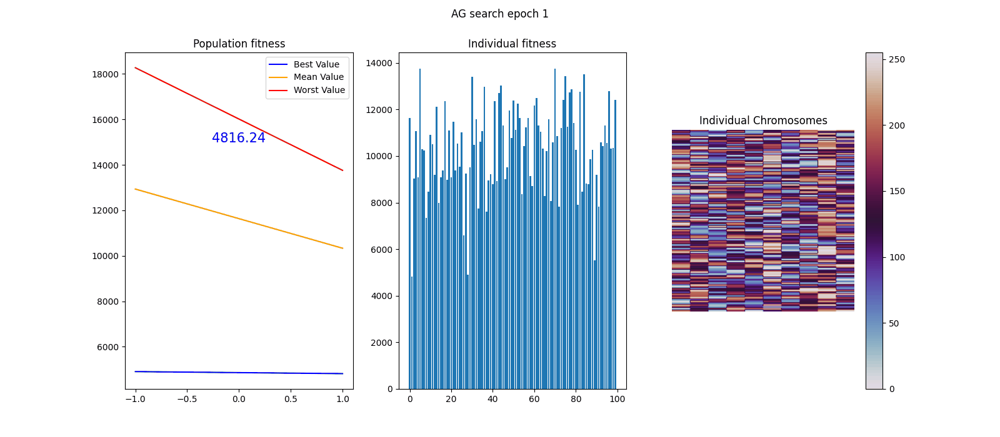

In [56]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['complete', 0.03]_In0.95_E30/video.gif")

Analizando el video del previo entrenamiento parece que si se hubiera escogido un númeor de épocas más alto se hubiera consegido la solución optima pero si nos fijamos en la evolución de los cromosomas vemos estructuras similares al problema anterior. ¿Ha convergido correctamente? o ¿Vuele a estar viciado por la mutación comleta?

La siguiente prueba se va a realizar igual que la anterior pero haciendo correctamente la mutación. Dejamos la mutación completa, que no parece adecuada para este problema y pasamos a la mutación parcial.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 30
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=0.95,optimization= None,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

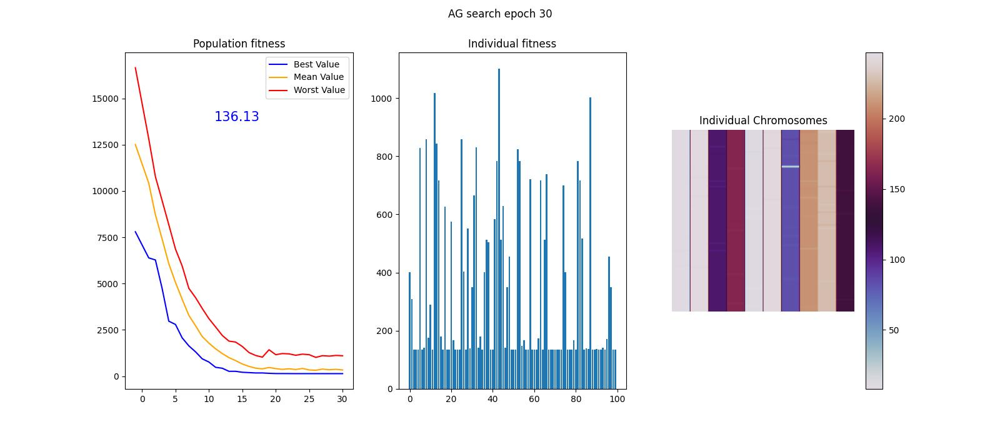

In [54]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['partial', 0.03]_In0.95_E30/images/image_epoch30.jpg")

La mutación parcial revela que el indicio de convergencia anterior se ha dado por la mutación completa. En esta última imagen, que corresponde a la mutación parcial, podemos apreciar que todos los individuos se han alineado y solo existen pequeñas mutaciones, que podemos apreciar en algunos colores mas oscuros o mas claros en los cromosomas. Esto implica que el acercamiento es incorrecto.

¿Es posible que se alineen los individuos porque escoger a los 5 mejores constantemente es un númeor muy alto? 

Para la siguiente prueba se va a crear la población completamente nueva exceptuando la inserción de el mejor individuo anterior.


In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 30
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=0.99,optimization= None,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

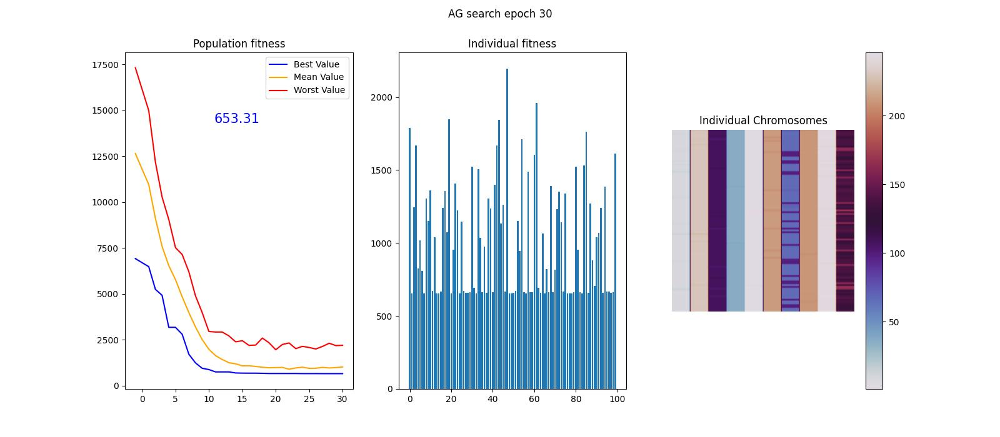

In [59]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['partial', 0.03]_In0.99_E30/images/image_epoch30.jpg")

Podemos ver que los individuos se han vuelto a alinear. Si revisamos el video podemos apreciar que desde la época 14 a la 30 el fitness del mejor individuo ha caido my poco a poco, se ha estancado. Estas 15 epocas ha ido bajando paulatinamente poco a poco encontrando mejores valores, esto se ha devido a la mutación parcial, los cromosomas se mueven en un espacio cercano optimazando el punto solución.

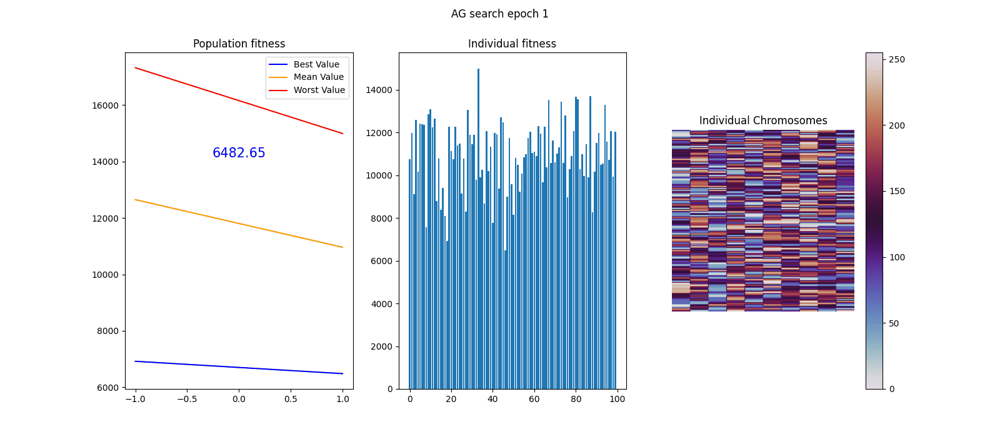

In [79]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['partial', 0.03]_In0.99_E30/video.gif")

Por último vamos a probar con los mismos valores pero sin mantener población anterior, con insercion completa.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization= None,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

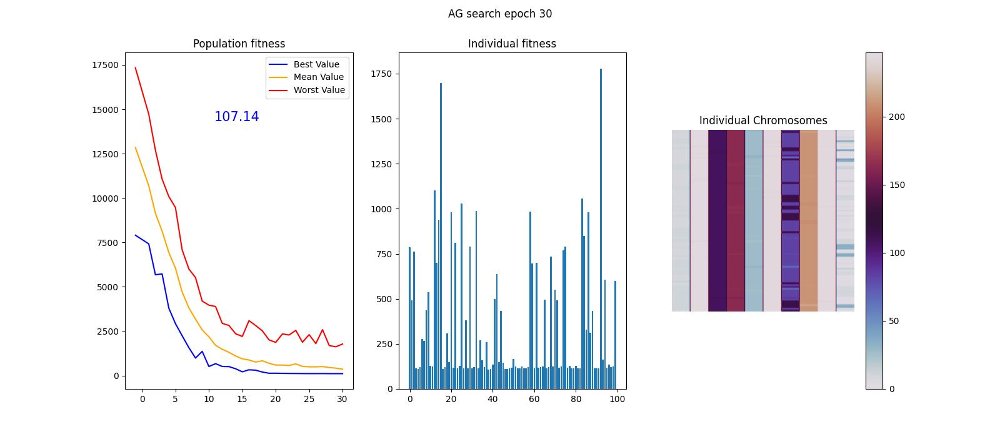

In [83]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_OpNone_Mut['partial', 0.03]_In1_E40/images/image_epoch30.jpg")

Podemos ver en la imagen anterior que el algoritmo no ha encontrado el óptimo. Se ha comportado de mejor manera que el anterior, llegando a una solución mas eficiente pero sin converger al 0. Podemos apreciar en la grafic que, al no haber insercion de previas poblaciones, el mejor indiviuo de una población puede ser peor que la de la anterior. No es una ciscurstancia alarmante ya que aun así converge pero es impotante destacarlo.

Hasta ahora no hemos hecho uso de una de las funcionalidades. Se ha desarrollado una estragia de optimización de los torneos que intrudce durante el entrenamiento presion selectiva. El optimizador redicve unos valores de toneros máximos y mínimos además de un step. En funcion del número de epocas se computarán los tamaños de los sucesivos torneos de la siguiente forma:

Optim -> {"min": 4,"max":8, "steps":1} crea un array con los siguientes valores [4, 5, 6, 7, 8] y el tamaño de torneo se ajusta de manera prgresiva en función del número de épocas de tal forma que esté el mismo número de epocas con cada valor. Un enrenaiento  de 20 épocas utilizará cada valor anterior 4 torneos.

Optim -> {"min": 4,"max":20, "steps":2} crea un array con los siguientes valores [4, 6, 8, 10, 12, 14, 16, 18, 20]

Es importante puntualizar que meter un optimizador distinto de 'None', como estabamos haciendo previamente, deja inutil el valor de entrada de tournament_size.

Para el primer experimento se va a utilizar una prsion selectiva gradual baja ( {"min": 4,"max":8, "steps":1} ) para ver como afecta con respecto al anterior.

Al estar ejecutando 40 épocas el valor del tamaño de los toneos va a cambair cada 8.


In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization={"min": 4,"max":8, "steps":1} ,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

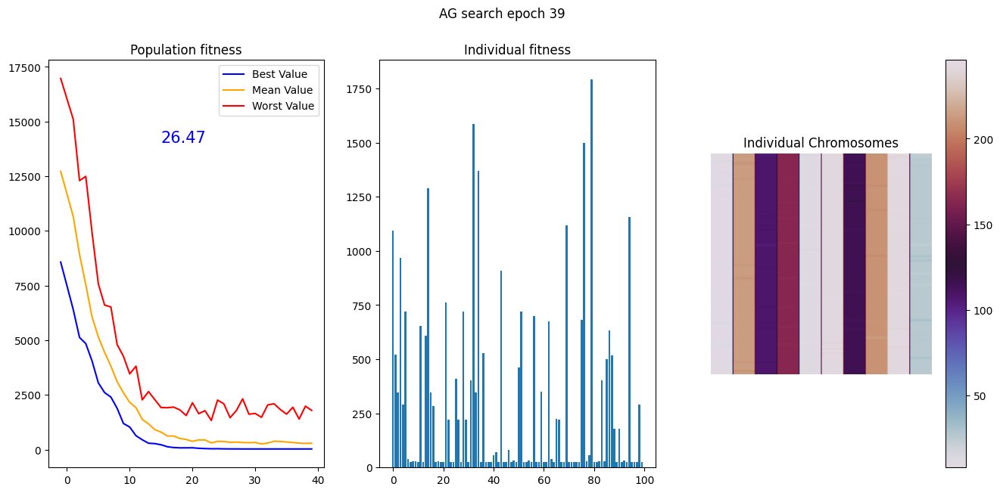

In [92]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T100_Op[4,8,1]_Mut['complete', 0.03]_In100_E40/images/image_epoch39.png")

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization={"min": 4,"max":20, "steps":2} ,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

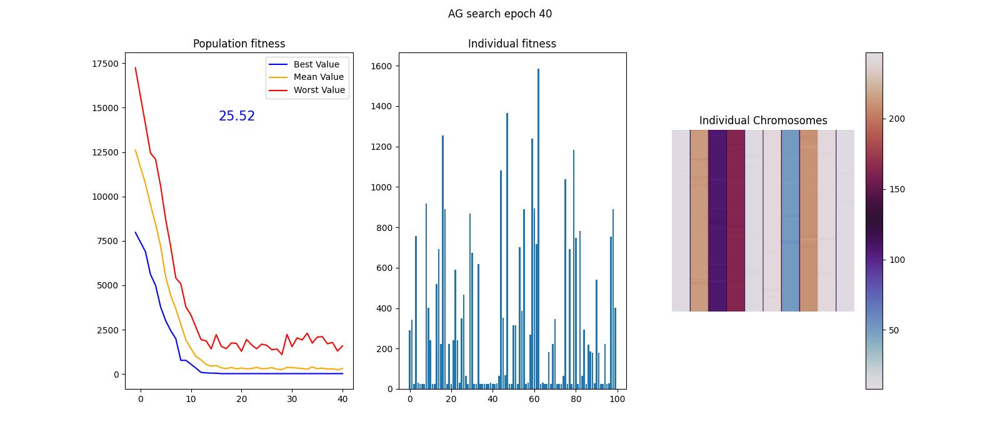

In [96]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/images/image_epoch40.jpg")

Podemos ver en la época 40 que el modelo se ha quedado estancado en un mínimo local y se ha desplazado poco desde entonces. La función de fitness debe ser bastante ruidosa. Podemos ver que la mayoría de individuos finales han acabado en valores muy similares, en cambio algunos valores de fitness son extremadamente altos.

Por el movimiento de los valores de fitness parece que el modelo necesitaba más exploración y menos presión selectiva. 

Para confirmar como de adecuados son los parámetros escogidos se va a relizar una bateria de pruebas de 5 modelos para estudiar su convergencia.

In [ ]:
modelos = []
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
for i in range(5):
  modelos.append(AlgoritmosGeneticos(pop_size,chro_size,gene_size))

for value,model in enumerate(modelos):
    print('Entrenando modelo {}'.format(value))
    model.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization= {"min": 4,"max":20, "steps":2},mutation= {"mtype": 'partial', "probability": 0.03}, save_results = False, plot_training = False)
    #model.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization= {"min": 4,"max":20, "steps":2},mutation= {"mtype": 'complete', "probability": 0.03}, save_results = False, plot_training = False)

def retreive_epochs(element):
    return element.last_train_results['Epoch'].iloc[-1]

def retreive_fitness(element):
    return element.last_train_results['Fitness Value'].iloc[-1]

fit = [retreive_fitness(element) for element in modelos]
epoch = [retreive_epochs(element) for element in modelos]

plt.scatter(range(len(fit)),fit)
plt.scatter(range(len(epoch)),epoch)
plt.title('Fitness and Epoch values')
plt.grid()

In [ ]:
for i, model in enumerate(modelos):
    plt.plot(model.last_train_results['Epoch'],model.last_train_results['Fitness Value'], label='Modelo {} - Best Value {}'.format(i,model.last_train_results['Fitness Value'].iloc[-1]))
plt.legend()

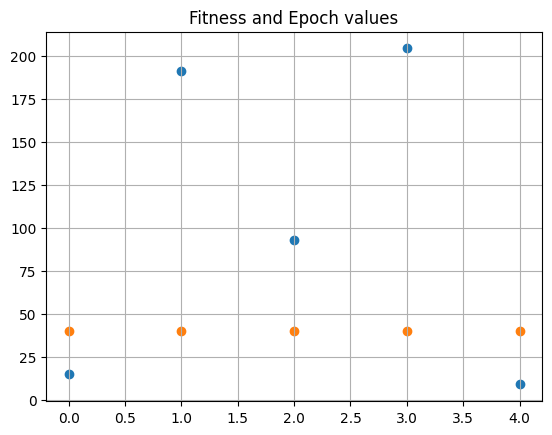

In [115]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/Complete_Batch.png")

Esta figura al igual que antes muestra los valores obtenidos de fitness y épocas de entrenamiento para cada uno de los cinco modelos. Podemos ver que ninguno ha llegado a cero y todos ellos han consumido las 40 iteraciones. Si nos fijamos en el siguiente gráfico los modelos convergen a un mínimo local de manera rápida y luego se estancan ahí.

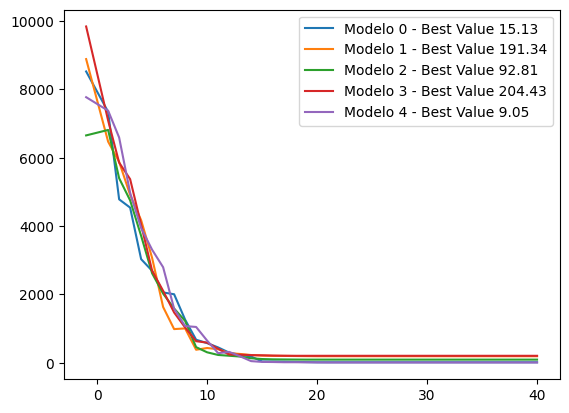

In [116]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/Graphics_Models.png")

In [ ]:
for i, model in enumerate(modelos):
    plt.plot(model.last_train_results['Epoch'].iloc[-30:],model.last_train_results['Fitness Value'].iloc[-30:], label='Modelo {} - Best Value {}'.format(i,model.last_train_results['Fitness Value'].iloc[-1]))
plt.legend()

La siguiente figura hace un zoom de las 30 últimas ejecuciones de cada uno de los modelos anteriores. Podemos apreciar ahora mejor que en la figura 20 todos ellos han llegado a una solución y que no se desplaza nada el mejor modelo de la población para ninguno de los valores. 

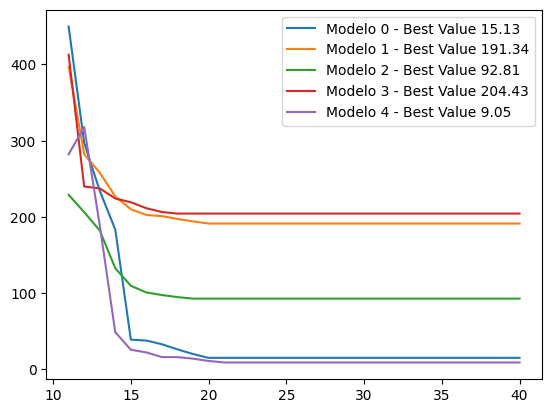

In [121]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/partial_graphics.png")

El problema que se aprecia es que una vez el modelo ecuentra una zona de mínimo local es complicado salir de ese punto. Una vez se llega a una buena solución es complicado, casi imposible salir de ese punto tal y como dice la teoria. 

- "Valores bajos también hacen caer en mínimos locales de los que es difícil salir"

Se ha realizado la mimsa prueba con el mismo optimizador del tamaño del tournament pero realizando una mutación completa. En los resultados vemos que de los cinco modelos que se han entrenado 4 de ellos han convergido a una solución optima menos uno que ha acabado con un fitness de 2.

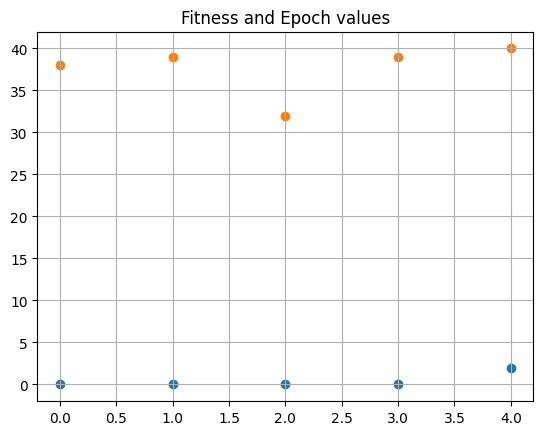

In [106]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['complete', 0.03]_In1_E40/Complete_Batch.png")

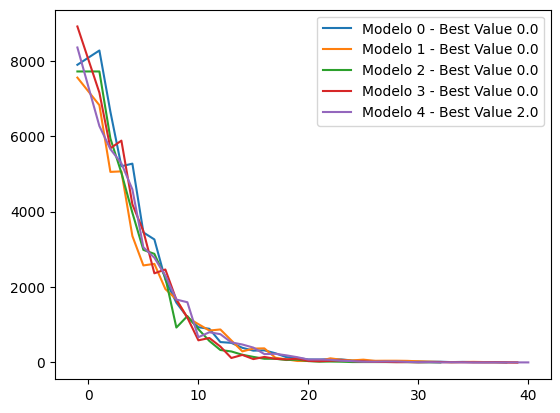

In [105]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['complete', 0.03]_In1_E40/Graphics_Models.png")

En este punto se ha desarrollado un nuevo tipo de motacion que se ha denominado 'boosted_partial'. Este nuevo método permite la variación del número de bits de mutación en función del valor de fitness de las últimas iteraciones. La reglas que se han puesto son:

- Si las últimas 3 ejecuciones tienen un fitness inferior a 1000 y igual entre ellas. Se incrementa el valor de bits. Como máximo se va a permitir un aumento de hasta 2 bits más. Pasando de 3 por defecto a 5 en el peor de los casos. 

Es posible que aún modificando ese valor no sea capaz de terminar de converger ya que depende de la forma de la función de fitness. Al final, si todos los individuos han entrado en un mínimo local y ahi es cuando se modifica el valor solo conseguiran salir si algunos individuos mutan tal que encuentren el 'hueco' donde se encuentra un valor más optimo. AUnque no parezca optimo, por explorar nuevas vías se va a desarrollar.

In [ ]:
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization={"min": 4,"max":20, "steps":2} ,mutation= {"mtype": 'boosted_partial', "probability": 0.03}, save_results = False, plot_training = False)

In [ ]:
plt.plot(AE.last_train_results['Epoch'].iloc[-27:],AE.last_train_results['Fitness Value'].iloc[-27:], label='Best Value {}'.format(AE.last_train_results['Fitness Value'].iloc[-1]))
plt.legend()
plt.title('Demostración de mutación cambiante')
plt.grid()

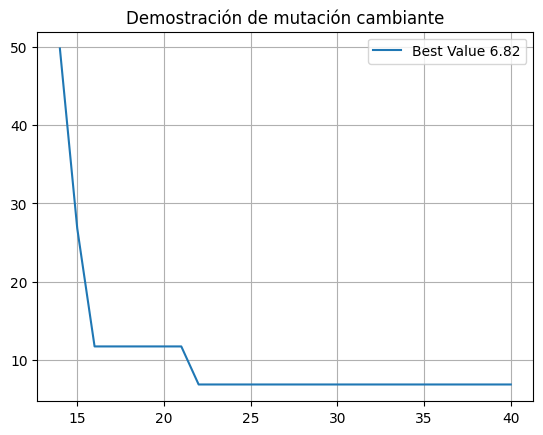

In [149]:
Image("resultados/AlgoritmosGeneticos/" + "mutacionvariante.png")

El gráfico de la ejecución de prueba nos permite ver que la idea no es mala. En una sola ejecución ha funcionado. El fitness ha variado de 11 a 6 depues de haber modificado el númeor de bitflips permitido. Aun así no ha encontrado el optimo global, el modelo se ha quedado estancado de nuevo en un mínimo local.

Se procede a hacer una batería rapida de pruebas para ver si es un comportamiento común. Se van a probar con 2 ejecuciones que con la anteior son 3 en total.

In [ ]:
modelos = []
pop_size,chro_size,gene_size = 100, 10, 8
training_epochs = 40
for i in range(2):
  modelos.append(AlgoritmosGeneticos(pop_size,chro_size,gene_size))

for value,model in enumerate(modelos):
    print('Entrenando modelo {}'.format(value))
    model.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization= {"min": 4,"max":20, "steps":2},mutation= {"mtype": 'boosted_partial', "probability": 0.03}, save_results = False, plot_training = False)


In [ ]:
for i, model in enumerate(modelos):
    plt.plot(model.last_train_results['Epoch'].iloc[-30:],model.last_train_results['Fitness Value'].iloc[-30:], label='Modelo {} - Best Value {}'.format(i,model.last_train_results['Fitness Value'].iloc[-1]))
plt.legend()

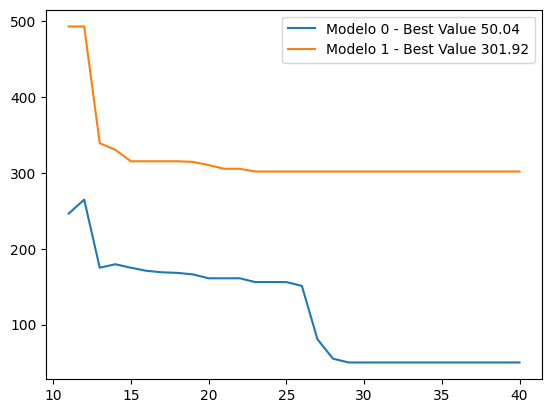

In [157]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I100_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['boosted_partial', 0.03]_In1_E40 copia/graphics.png")


Podemos confirmar que siempre converge una vez más aunque no encuentra el valor optimo.

Finalmente se va a porbar a variar el único parámetro que no se ha probado aún que es el número de individuos en una población. Esta prueba la vamos a realizar con los mejores hiperparámetros obtenidos con mutación parcial normal.

In [ ]:
pop_size,chro_size,gene_size = 300, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size)
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization={"min": 4,"max":20, "steps":2} ,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

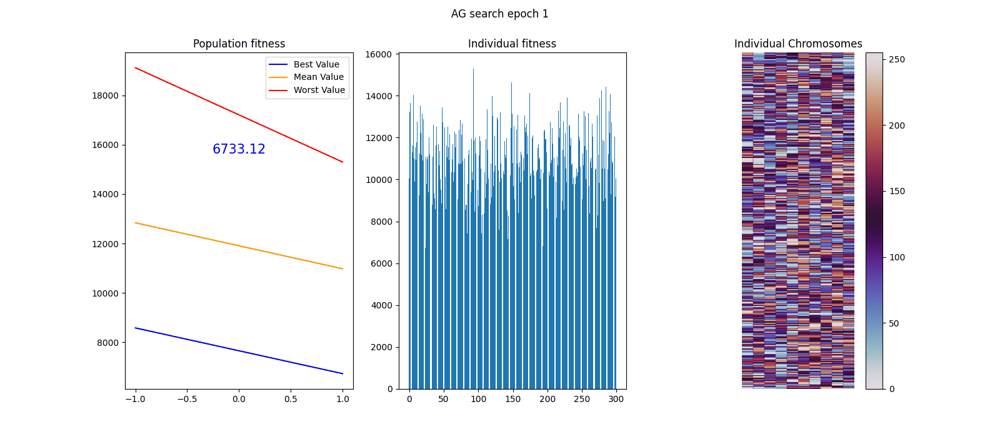

In [169]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Ftest_I300_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/video.gif")

Podemos ver en el video de la ejecución que la primera prueba de población 300 ha convergido en nada más que 20 ejecuciones. 

En este video es muy interesante ver como converge cada cromosoma al optimo. Vemos como cada columna de el último subplot se va armonizando a medida que pasan las iteraciones. En la iteración número 11 podemos ver la primera completa, y luego ya en la 17 se unen varias al mimso tiempo.

Se realiza la batería de pruebas correspondiente para confirmar que siempre converge.

In [ ]:
modelos = []
pop_size,chro_size,gene_size = 300, 10, 8
training_epochs = 40
for i in range(5):
  modelos.append(AlgoritmosGeneticos(pop_size,chro_size,gene_size))

for value,model in enumerate(modelos):
    print('Entrenando modelo {}'.format(value))
    model.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization= {"min": 4,"max":20, "steps":2},mutation= {"mtype": 'partial', "probability": 0.03}, save_results = False, plot_training = False)


In [ ]:
def retreive_epochs(element):
    return element.last_train_results['Epoch'].iloc[-1]

def retreive_fitness(element):
    return element.last_train_results['Fitness Value'].iloc[-1]

fit = [retreive_fitness(element) for element in modelos]
epoch = [retreive_epochs(element) for element in modelos]

plt.scatter(range(len(fit)),fit)
plt.scatter(range(len(epoch)),epoch)
plt.title('Fitness and Epoch values')
plt.grid()

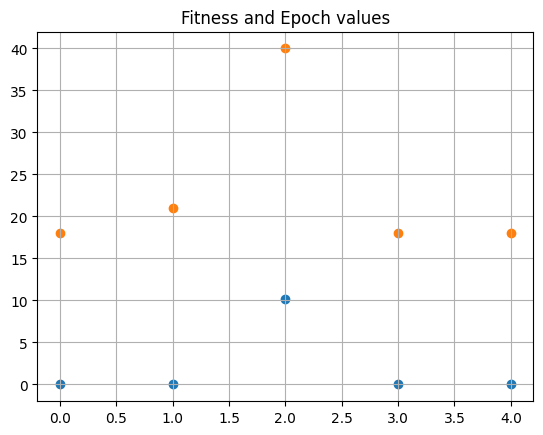

In [172]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I300_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/results.png")


In [ ]:
for i, model in enumerate(modelos):
    plt.plot(model.last_train_results['Epoch'],model.last_train_results['Fitness Value'], label='Modelo {} - Best Value {}'.format(i,model.last_train_results['Fitness Value'].iloc[-1]))
plt.legend()

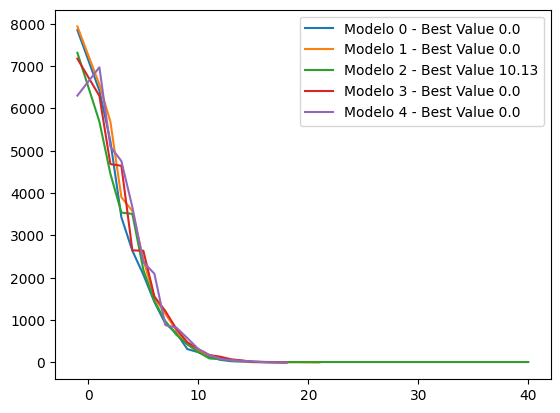

In [174]:
Image("resultados/AlgoritmosGeneticos/" + "Batch_AG_Ftest_I300_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/graphics.png")


Podemos ver por la bateria de pruebas y por la prueba anterior que el aumento de población implica que el modelo converja gran parte de las veces. Al final el espacio de soluciones es de 256^10, valor que se aproxima a 1^24. Cuantos más valores pruebas simultaneamente más probable es que uno se cuele en una de las soluciones óptimas.

Algo que esta claro es que los puntos inciales son muy importantes. Dentro del mundo de la IA existen muchos estudios que apuntan a que con una incialización estudiada se puede llegar a mejores soluciones. En la ultima sección de esta parte de trabajo se propone una de las posibles inicializaciones aparentemente optimas para un problema como este.

### Pruebas funciones alfa y easydc

Depues de realizar algunas pruebas rápidas uno se da cuenta que estas funciones no se comportan de la misma manera que la de test. Las funciones tienen una componente de tiempo. Haciendo pruebas con  determinados indiviuos se ve que estos van modificando el fitness a lo largo del tiempo. Para resolver estas funciones va a ser necesaria la implementación de coevolución vista en clase.

In [162]:
for i in range(0,10):
    print(requests.get('http://memento.evannai.inf.uc3m.es/age/alfa?c=00001001111101100110110010100100000010111111010001110011110100101111010010001010').text)

1.39021176337
1.39231509338
1.38724290255
1.38837952245
1.39171414013
1.38941349168
1.39048962346
1.3900018839
1.38882126881
1.3909026407


In [159]:
for i in range(0,10):
    print(requests.get('http://memento.evannai.inf.uc3m.es/age/easydc?c=00001001111101100110110010100100000010111111010001110011110100101111010010001010').text)

221143.104
244423.688704
219663.759872
276344.543744
260626.159104
244496.848384
280946.631168
255191.285248
141634.744832
274201.006592


Podemos ver que una de las funciones tiene una variable 'temporal' aparentemente mucho mas fuerte que la anterior. Aun asi se han realizado algunas pruebas sobre estas funciones con el mejor método anterior a modo de comparativa rapida de la dificultad que puede suponer estas nuevas funciones.

In [ ]:
pop_size,chro_size,gene_size = 300, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size,fitness_function = 'alfa')
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization={"min": 4,"max":20, "steps":2} ,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

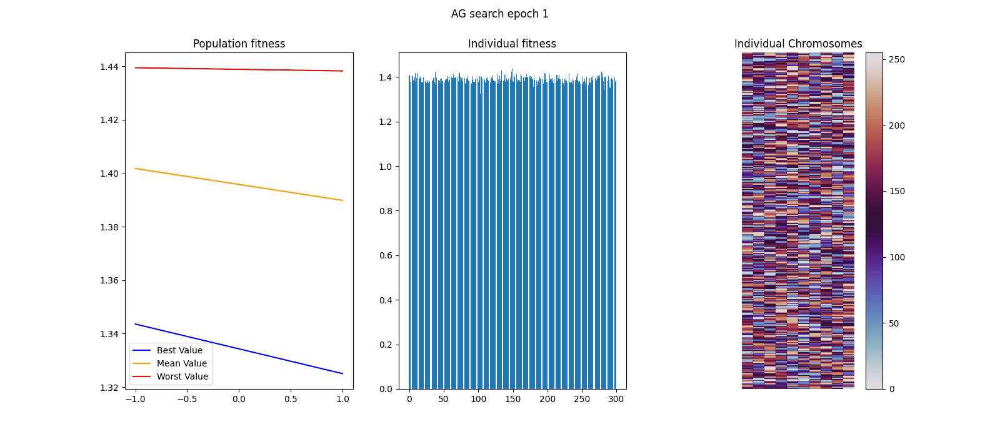

In [177]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Falfa_I300_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/video.gif")


In [ ]:
pop_size,chro_size,gene_size = 300, 10, 8
training_epochs = 40
AE = AlgoritmosGeneticos(pop_size,chro_size,gene_size,fitness_function = 'easydc')
video_name = AE.search(training_epochs,tournament_size = 4,insercion_volume=1,optimization={"min": 4,"max":20, "steps":2} ,mutation= {"mtype": 'partial', "probability": 0.03}, save_results = True, plot_training = True)

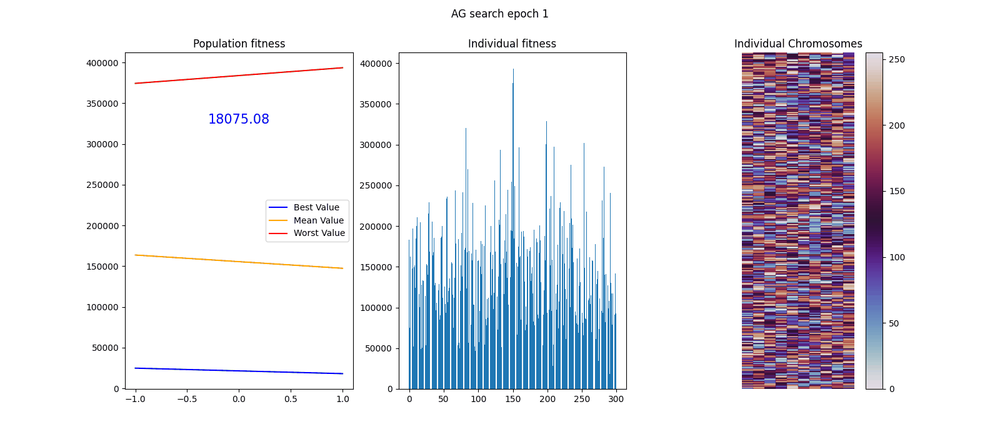

In [180]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Feasydc_I300_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/video.gif")


Podemos ver en el video de la búsqueda que el algoritmo encuentra una solución baja, lejos de la optima. La dimensión de el peor valor de cada irteración compila la visibilidad de la gráfica pero el modelo ha convergido a una solución de valor que ronda los 7000 de fitness.

In [ ]:
plt.plot(AE.last_train_results['Epoch'],AE.last_train_results['Fitness Value'], label='Best Value',color = 'blue')
plt.legend()
plt.title('Population Fitness')

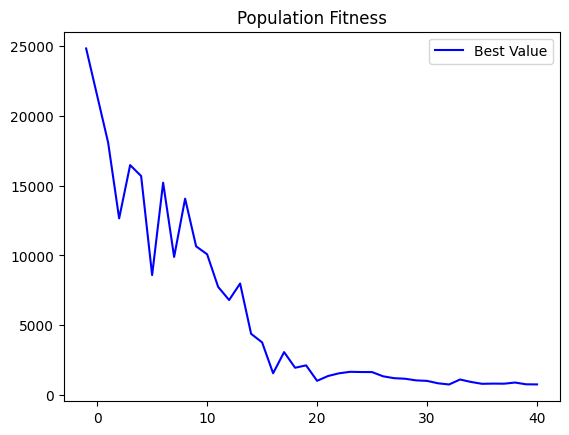

In [185]:
Image("resultados/AlgoritmosGeneticos/" + "AG_Feasydc_I300_Ch10_G8_Mtournament_T4_Op[4, 20, 2]_Mut['partial', 0.03]_In1_E40/zoomed.png")

### Trabajo futuro

Muchas técnicas se han quedado sin poder implementar debido al justo tiempo.

- Inicialización no completamente pseudo - aleatoria. Actualmente se han puesto los puntos iniciales  de manera aleatoria pero sería interesante analizar los cambios si delimitamos el espacio de soluciones por zonas y dentro de esas zonas creamos de manera aleatoria pero controlada a los individuos. De esta manera nos aseguramos que por cada ejecución gran parte del espacio de soluciones sea computado.

- Más modelos de selección u cruce.
    *   La selección por ruleta no se ha probado ya que se ha desarrollado para la segunda parte pero hubiera estado interesante ver, en comparación con el torneo, como se hubiera compoartado la convergencia. 
    * Cruce por cromosomas. Actualmente se esta cruzando de dos en dos individuos a nivel de bit pero hubiera podido estar interesante cruzar a nivel de cromosoma completo, que es al final el que determina la adecuación de ese valor que se está buscando.
    

- Más pruebas esperimentales en las funciones de alfa y easydc. Aunque parezca que las funciones de alfa y easydc están pesadas para las proximas prácticas debido a su componente aleatoria poder haber tenido mas tiempo para ver como se comporta el modelo en funciones de fitness as complejas.